## Import Modules

In [30]:
import os
import numpy as np
import matplotlib.pyplot as plt
import warnings
from tqdm.notebook import tqdm

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img,array_to_img
from tensorflow.keras.models import Sequential,Model
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy
warnings.filterwarnings("ignore")

## Load files

In [31]:
BASE_DIR="/kaggle/input/anime-faces/data/"


In [32]:
image_paths=[]
for image in os.listdir(BASE_DIR):
    image_path=os.path.join(BASE_DIR,image)
    image_paths.append(image_path)

In [33]:
image_paths.remove("/kaggle/input/anime-faces/data/data")

In [34]:
len(image_paths)

21551

## Visualizing images

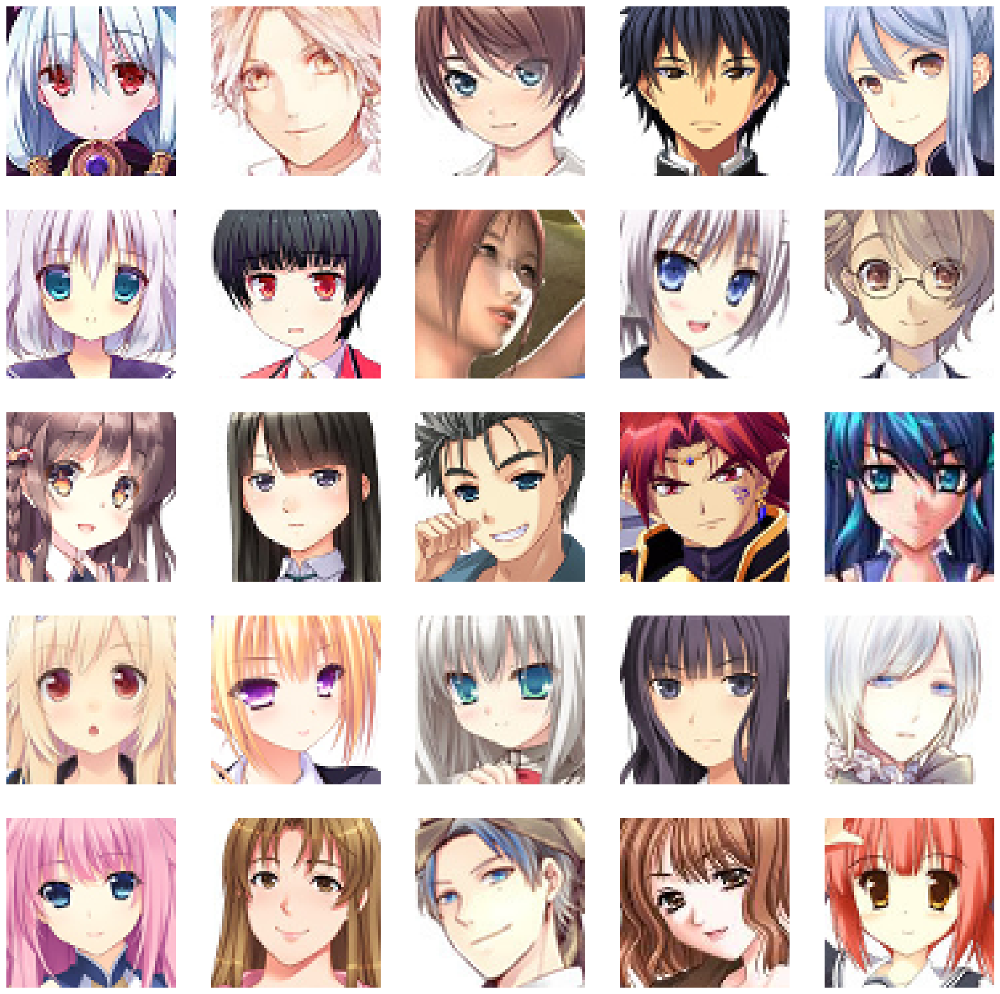

In [35]:
plt.figure(figsize=(20,20))
temp_images=image_paths[:25]
index=1
for image_path in temp_images:
    plt.subplot(5,5,index)
    img=load_img(image_path)
    img=np.array(img)
    plt.imshow(img)
    plt.axis("off")
    index=index+1


## Preprocesssing

In [36]:
#loading images and converting to numpy array
train_images=[np.array(load_img(path)) for path in tqdm(image_paths)]
train_images=np.array(train_images)

  0%|          | 0/21551 [00:00<?, ?it/s]

In [37]:
train_images[0].shape

(64, 64, 3)

In [38]:
train_images=train_images.reshape(train_images.shape[0],64,64,3).astype("float32")

In [39]:
train_images=(train_images-127.5)/127.5

In [40]:
train_images[0]

array([[[-0.7254902 , -0.90588236, -0.7176471 ],
        [-0.70980394, -0.88235295, -0.6862745 ],
        [-0.7019608 , -1.        , -0.7176471 ],
        ...,
        [-0.09019608,  0.01176471,  0.3882353 ],
        [-0.19215687,  0.05882353,  0.4509804 ],
        [-0.34117648, -0.13725491,  0.29411766]],

       [[-0.7254902 , -0.90588236, -0.7176471 ],
        [-0.73333335, -0.8666667 , -0.7019608 ],
        [-0.52156866, -0.8666667 , -0.5686275 ],
        ...,
        [-0.29411766,  0.01176471,  0.3019608 ],
        [-0.08235294,  0.15294118,  0.5294118 ],
        [-0.23921569,  0.09019608,  0.45882353]],

       [[-0.7019608 , -0.8901961 , -0.7019608 ],
        [-0.7176471 , -0.8745098 , -0.69411767],
        [-0.5686275 , -0.8509804 , -0.58431375],
        ...,
        [-0.22352941,  0.1764706 ,  0.48235294],
        [-0.13725491,  0.1764706 ,  0.4745098 ],
        [-0.06666667,  0.24705882,  0.5058824 ]],

       ...,

       [[-0.30980393, -0.6862745 , -0.29411766],
        [-0

## Creating generator and discriminator models

In [41]:
#latent dimension for random noise
LATENT_DIM=100
#weight initialization
WEIGHT_INIT=keras.initializers.RandomNormal(mean=0.0,stddev=0.02)
#no of channels of img
CHANNELS=3 #RGB


### generator model


In [42]:
model=Sequential(name="generator")

#layer1 1d random noise
model.add(layers.Dense(8*8*512,input_dim=LATENT_DIM))
#model.add(layers.BatchNormalization())
model.add(layers.ReLU())

#convert 1d to 3d
model.add(layers.Reshape((8,8,512)))

#upsample to 16x16
model.add(layers.Conv2DTranspose(256,(4,4),strides=(2,2),padding="same",kernel_initializer=WEIGHT_INIT))
#model.add(layers.BatchNormalization())
model.add(layers.ReLU())

#upsample to 32x32
model.add(layers.Conv2DTranspose(128,(4,4),strides=(2,2),padding="same",kernel_initializer=WEIGHT_INIT))
#model.add(layers.BatchNormalization())
model.add(layers.ReLU())

#upsample to 64x64
model.add(layers.Conv2DTranspose(64,(4,4),strides=(2,2),padding="same",kernel_initializer=WEIGHT_INIT))
#model.add(layers.BatchNormalization())
model.add(layers.ReLU())

model.add(layers.Conv2D(CHANNELS,(4,4),padding="same",activation="tanh"))
generator=model
generator.summary()

Model: "generator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_2 (Dense)                 │ (None, 32768)          │     3,309,568 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_4 (ReLU)                  │ (None, 32768)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape_1 (Reshape)             │ (None, 8, 8, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_3              │ (None, 16, 16, 256)    │     2,097,408 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_5 (ReLU)                  │ (None, 16, 16, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_4              │ (None, 32, 32, 128)    │       524,416 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_6 (ReLU)                  │ (None, 32, 32, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_5              │ (None, 64, 64, 64)     │       131,136 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_7 (ReLU)                  │ (None, 64, 64, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 64, 64, 3)      │         3,075 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,065,603 (23.14 MB)

 Trainable params: 6,065,603 (23.14 MB)

 Non-trainable params: 0 (0.00 B)

### discriminator model

In [43]:
model=Sequential(name="discriminator")
input_shape=(64,64,3)
alpha=0.2

#conv layers
model.add(layers.Conv2D(64,(4,4),strides=(2,2),padding="same",input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128,(4,4),strides=(2,2),padding="same",input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128,(4,4),strides=(2,2),padding="same",input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.3))

model.add(layers.Dense(1,activation="sigmoid"))
discriminator=model
discriminator.summary()

Model: "discriminator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_5 (Conv2D)               │ (None, 32, 32, 64)     │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_7           │ (None, 32, 32, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_3 (LeakyReLU)       │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_6 (Conv2D)               │ (None, 16, 16, 128)    │       131,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_8           │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_4 (LeakyReLU)       │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_7 (Conv2D)               │ (None, 8, 8, 128)      │       262,272 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_9           │ (None, 8, 8, 128)      │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_5 (LeakyReLU)       │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 1)              │         8,193 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 406,081 (1.55 MB)

 Trainable params: 405,441 (1.55 MB)

 Non-trainable params: 640 (2.50 KB)

## DCGAN

In [44]:
class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')
        
    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric]
    
    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn
        
    def train_step(self, real_images):
        # get batch size from the data
        batch_size = tf.shape(real_images)[0]
        # generate random noise
        random_noise = tf.random.normal(shape=(batch_size, self.latent_dim))
        
        # train the discriminator with real (1) and fake (0) images
        with tf.GradientTape() as tape:
            # compute loss on real images
            pred_real = self.discriminator(real_images, training=True)
            # generate real image labels
            real_labels = tf.ones((batch_size, 1))
            # label smoothing
            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels))
            d_loss_real = self.loss_fn(real_labels, pred_real)
            
            # compute loss on fake images
            fake_images = self.generator(random_noise)
            pred_fake = self.discriminator(fake_images, training=True)
            # generate fake labels
            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)
            
            # total discriminator loss
            d_loss = (d_loss_real + d_loss_fake) / 2
            
        # compute discriminator gradients
        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)
        # update the gradients
        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))
        
        
        # train the generator model
        labels = tf.ones((batch_size, 1))
        # generator want discriminator to think that fake images are real
        with tf.GradientTape() as tape:
            # generate fake images from generator
            fake_images = self.generator(random_noise, training=True)
            # classify images as real or fake
            pred_fake = self.discriminator(fake_images, training=True)
            # compute loss
            g_loss = self.loss_fn(labels, pred_fake)
            
        # compute gradients
        gradients = tape.gradient(g_loss, self.generator.trainable_variables)
        # update the gradients
        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))
        
        # update states for both models
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)
        
        return {'d_loss': self.d_loss_metric.result(), 'g_loss': self.g_loss_metric.result()}

In [45]:
class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self,num_imgs=25,latent_dim=100):
        self.num_imgs=num_imgs
        self.latent_dim=latent_dim
        #random noise for generating images
        self.noise=tf.random.normal([25,latent_dim])
        
    def on_epoch_end(self,epoch,logs=None):
        g_img=self.model.generator(self.noise)
        #denormalising the images
        g_img=(g_img*127.5) + 127.5
        g_img.numpy()
        
        fig=plt.figure(figsize=(8,8))
        for i in range(self.num_imgs):
            plt.subplot(5,5,i+1)
            img=array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis("off")
            
        plt.show()
        
    def on_train_end(self,logs="None"):
        self.model.generator.save("generator.h5")

In [46]:
dcgan = DCGAN(generator=generator, discriminator=discriminator, latent_dim=LATENT_DIM)

In [47]:
D_LR=0.0001
G_LR=0.0003
dcgan.compile(g_optimizer=Adam(learning_rate=G_LR,beta_1=0.5),d_optimizer=Adam(learning_rate=D_LR,beta_1=0.5),loss_fn=BinaryCrossentropy())



Epoch 1/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step - d_loss: 1.3586 - g_loss: 1.7186

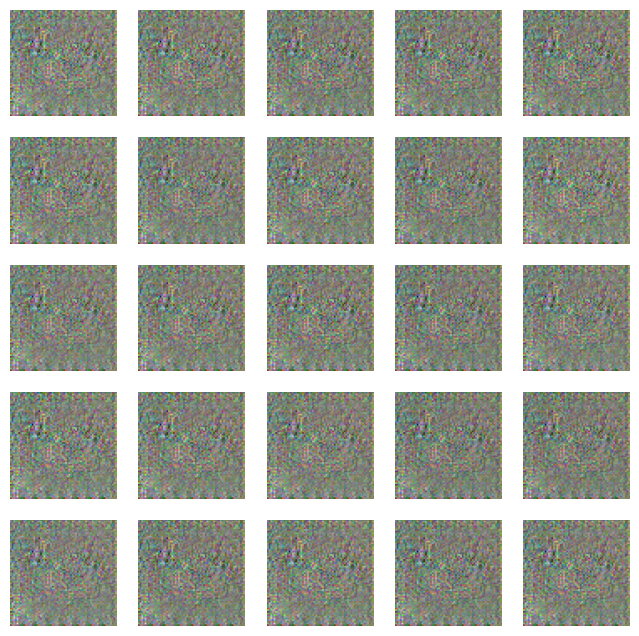

674/674 ━━━━━━━━━━━━━━━━━━━━ 49s 50ms/step - d_loss: 1.3576 - g_loss: 1.7200
Epoch 2/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - d_loss: 0.2053 - g_loss: 3.1655

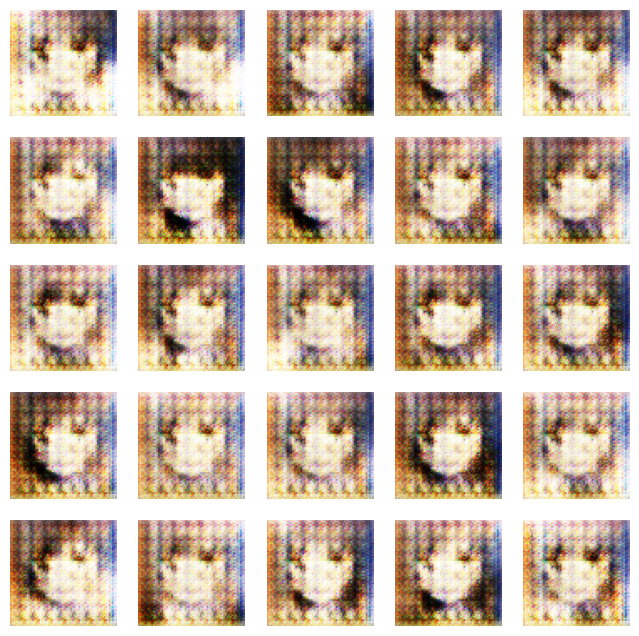

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.2059 - g_loss: 3.1634
Epoch 3/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - d_loss: 0.5809 - g_loss: 1.6212

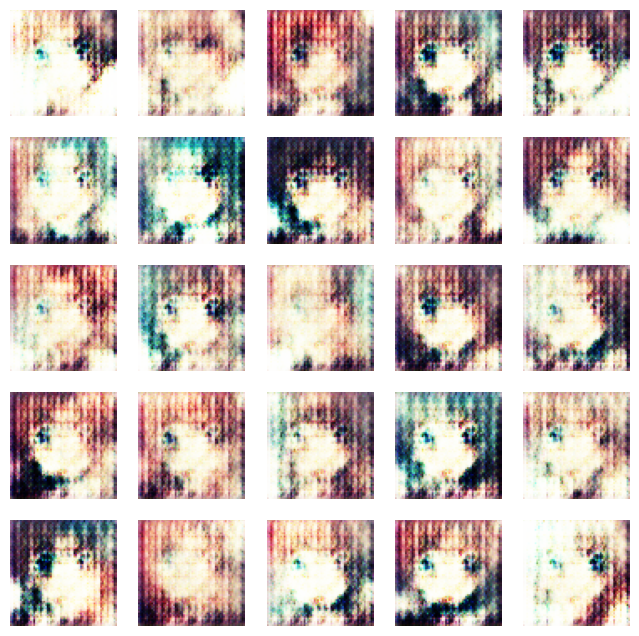

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.5810 - g_loss: 1.6210
Epoch 4/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - d_loss: 0.6116 - g_loss: 1.5855

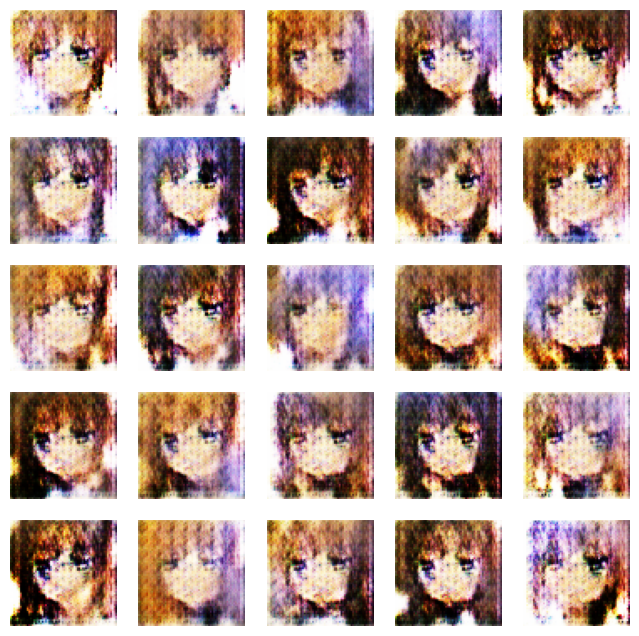

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 32ms/step - d_loss: 0.6116 - g_loss: 1.5855
Epoch 5/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.5923 - g_loss: 1.5918

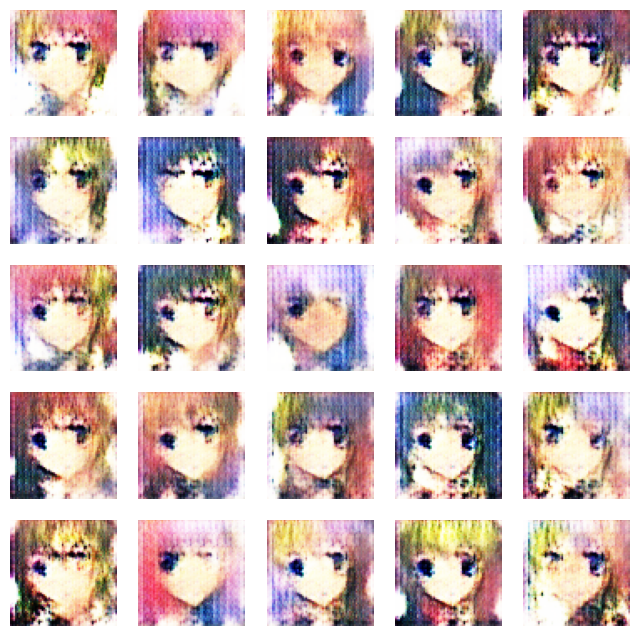

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.5923 - g_loss: 1.5918
Epoch 6/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.5905 - g_loss: 1.6818

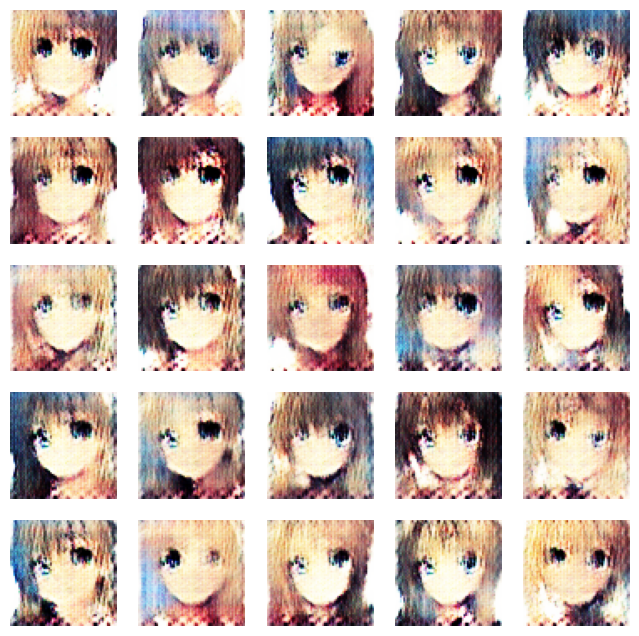

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.5905 - g_loss: 1.6818
Epoch 7/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - d_loss: 0.6363 - g_loss: 1.4315

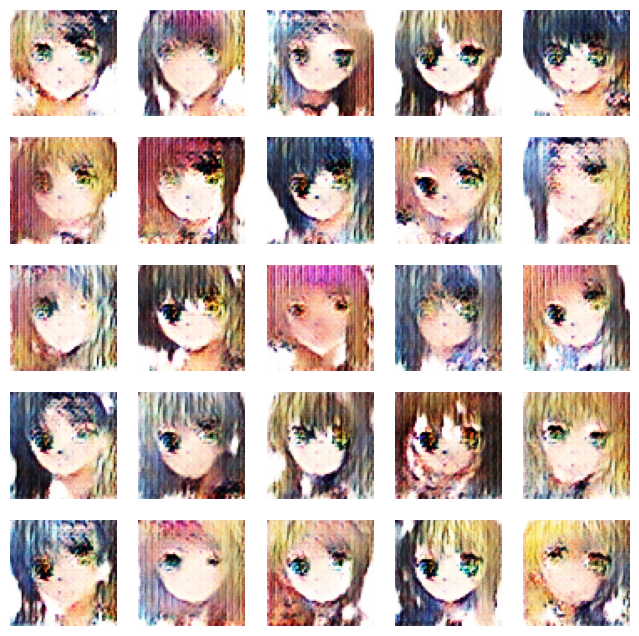

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.6363 - g_loss: 1.4312
Epoch 8/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6861 - g_loss: 1.2036

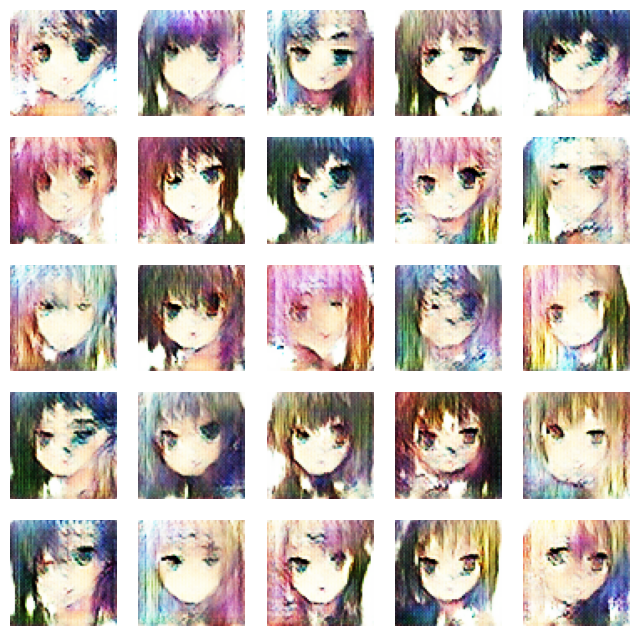

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.6861 - g_loss: 1.2035
Epoch 9/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6816 - g_loss: 1.0831

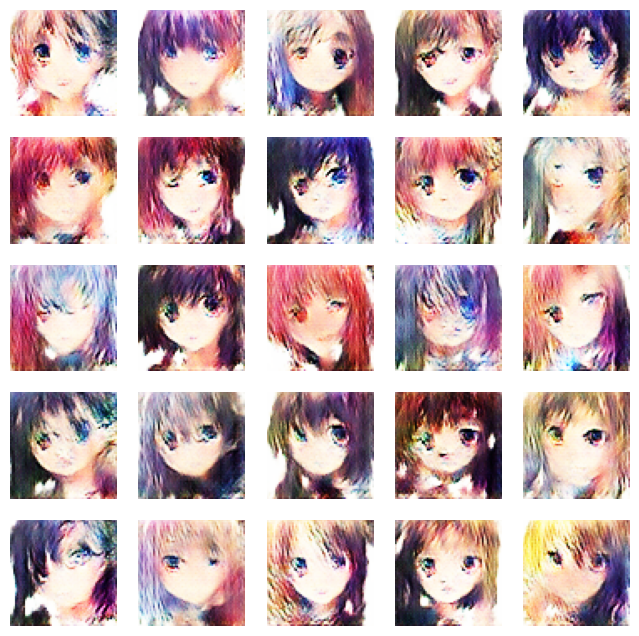

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.6816 - g_loss: 1.0832
Epoch 10/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - d_loss: 0.6994 - g_loss: 0.9916

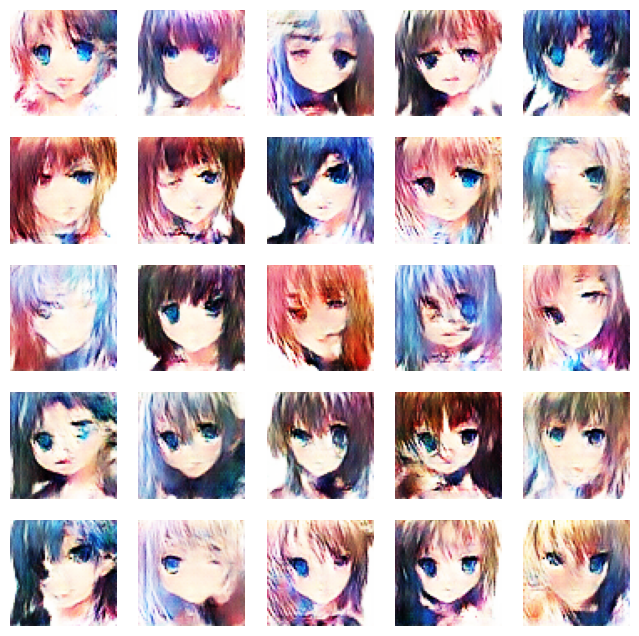

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.6994 - g_loss: 0.9915
Epoch 11/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - d_loss: 0.7292 - g_loss: 0.8895

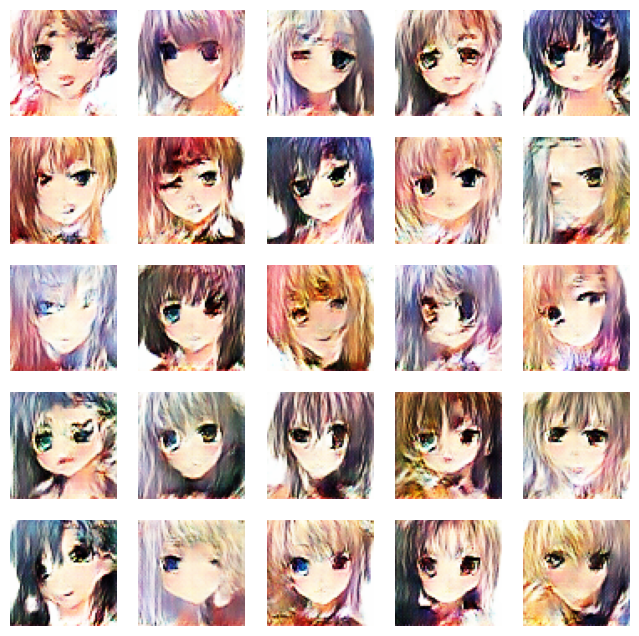

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.7292 - g_loss: 0.8895
Epoch 12/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.7231 - g_loss: 0.8497

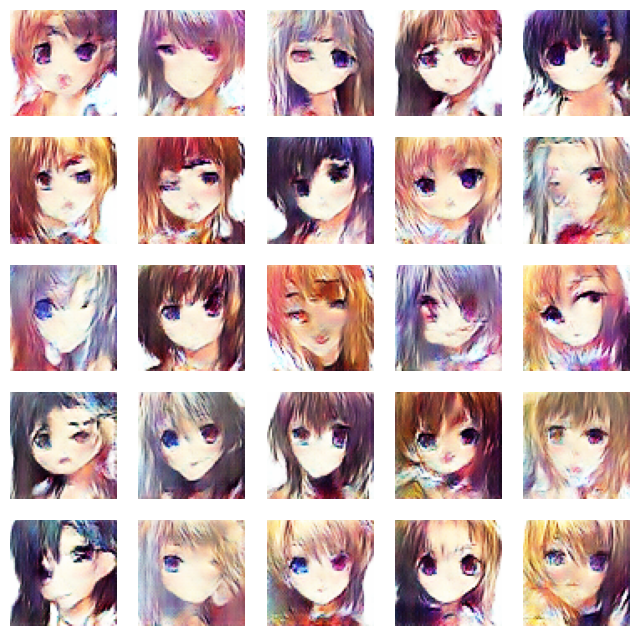

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.7231 - g_loss: 0.8497
Epoch 13/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.7231 - g_loss: 0.8135

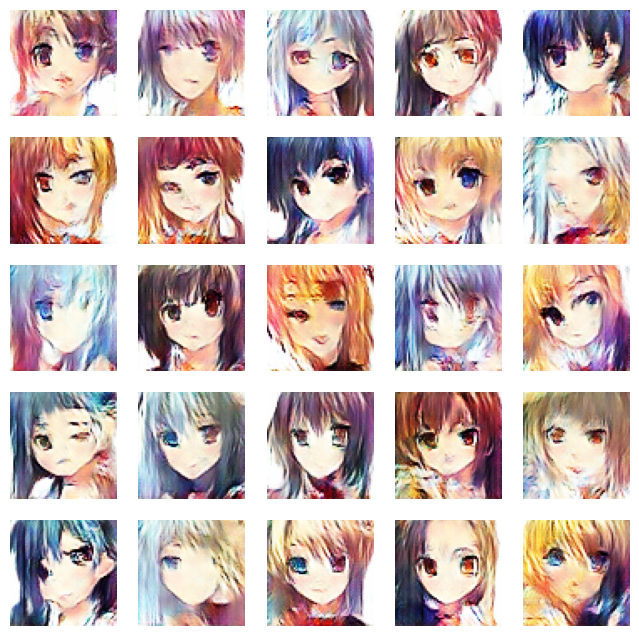

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 32ms/step - d_loss: 0.7231 - g_loss: 0.8134
Epoch 14/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.7158 - g_loss: 0.8027

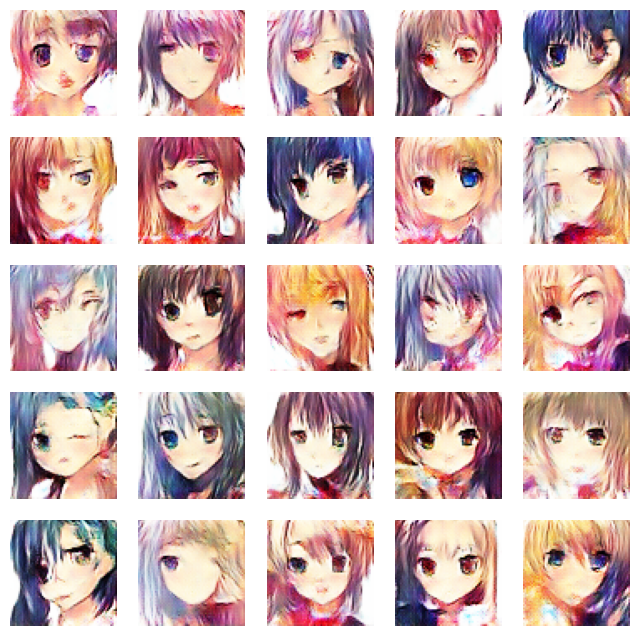

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.7158 - g_loss: 0.8027
Epoch 15/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.7103 - g_loss: 0.7921

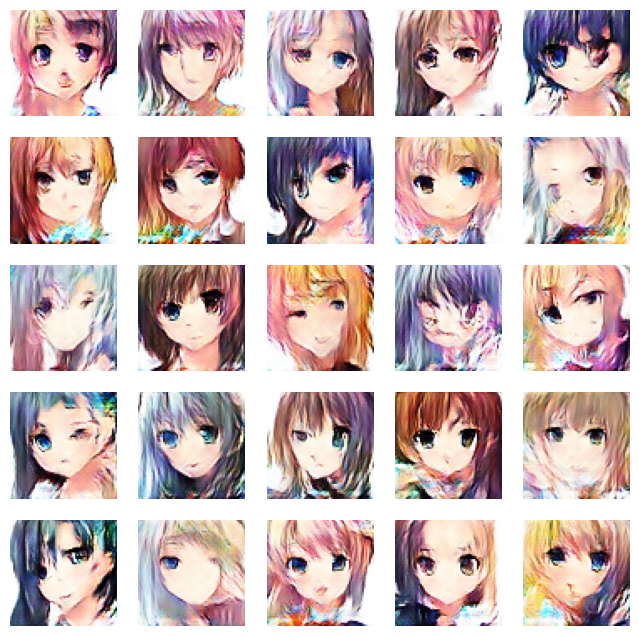

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.7103 - g_loss: 0.7921
Epoch 16/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.7045 - g_loss: 0.7730

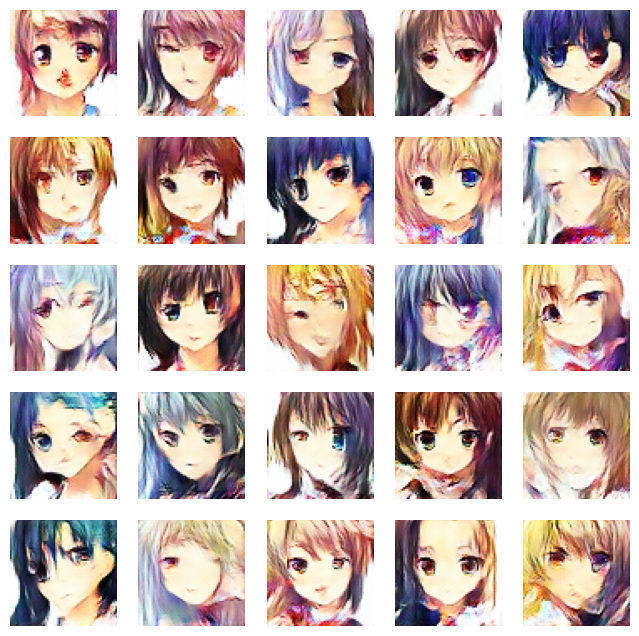

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.7045 - g_loss: 0.7731
Epoch 17/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.7049 - g_loss: 0.7790

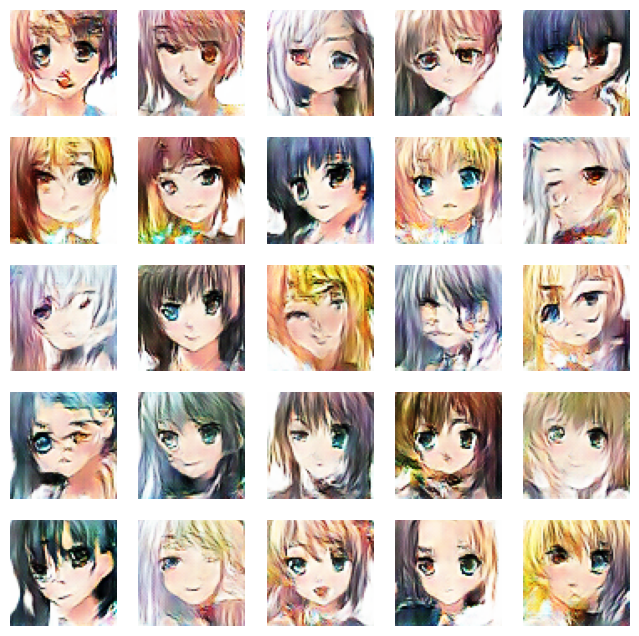

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.7049 - g_loss: 0.7790
Epoch 18/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.7041 - g_loss: 0.7724

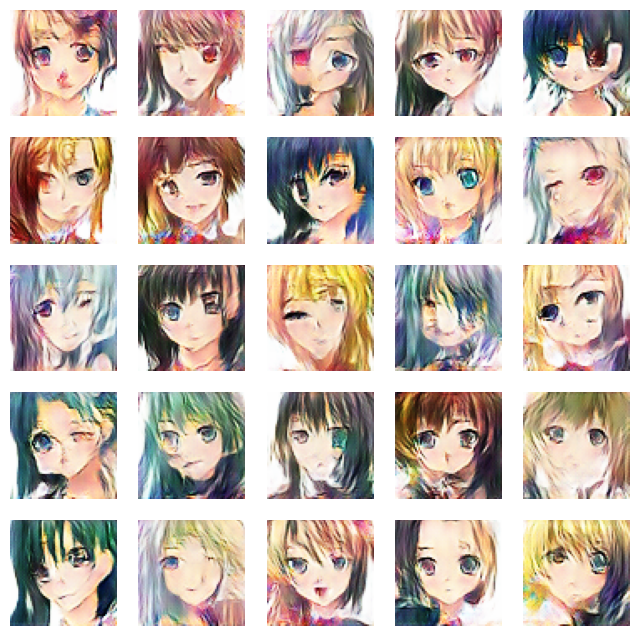

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 32ms/step - d_loss: 0.7040 - g_loss: 0.7724
Epoch 19/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6999 - g_loss: 0.7696

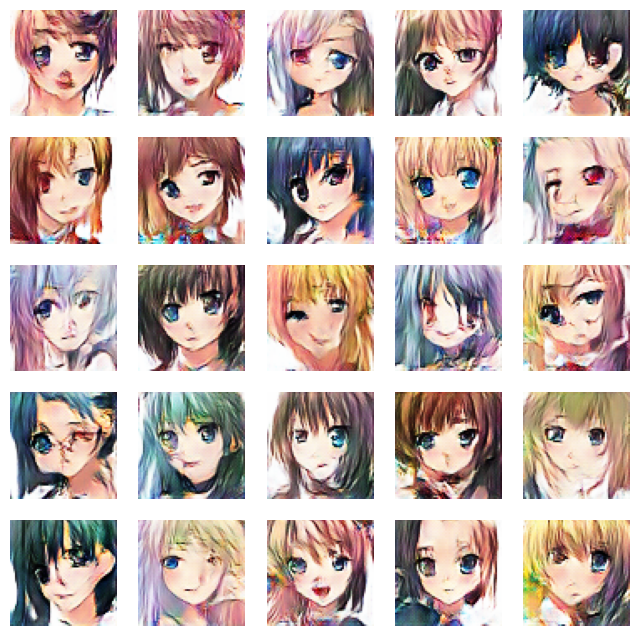

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.6999 - g_loss: 0.7696
Epoch 20/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.7016 - g_loss: 0.7714

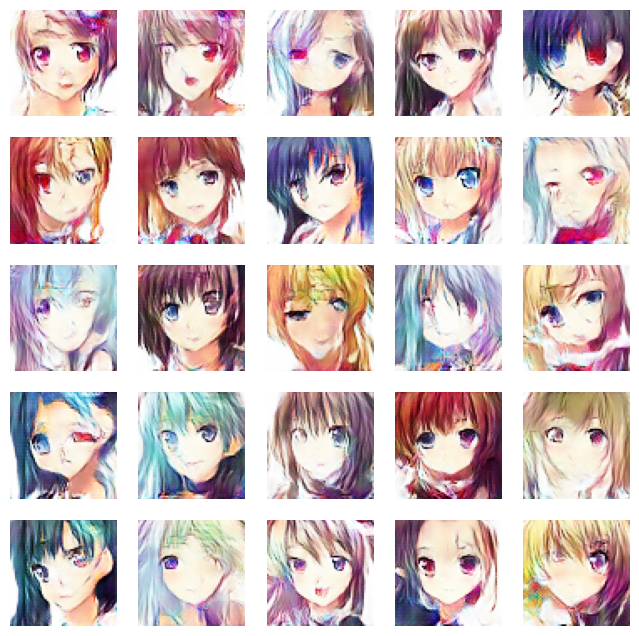

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.7016 - g_loss: 0.7713
Epoch 21/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6992 - g_loss: 0.7595

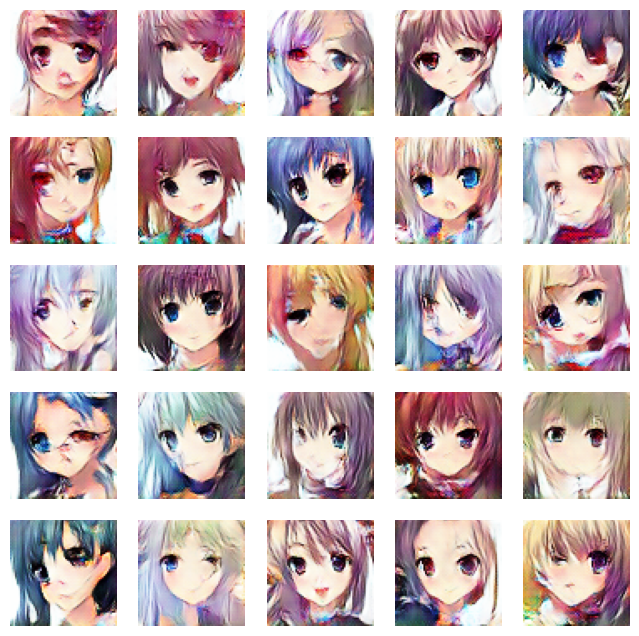

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.6991 - g_loss: 0.7595
Epoch 22/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6990 - g_loss: 0.7671

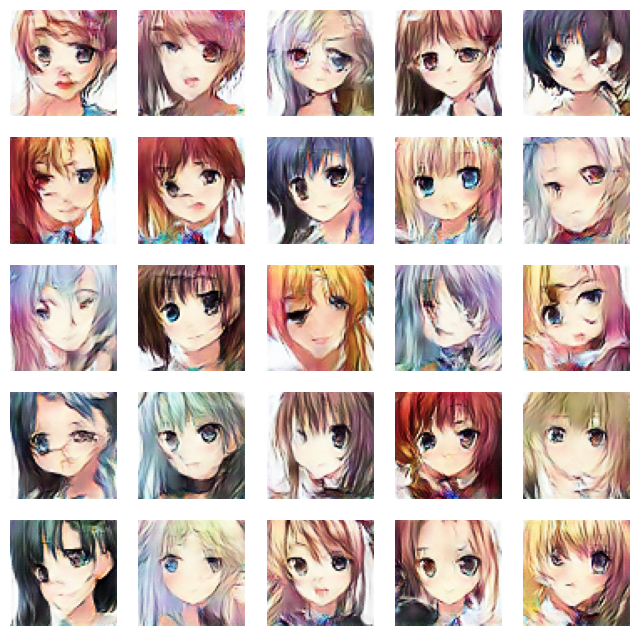

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.6990 - g_loss: 0.7670
Epoch 23/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6935 - g_loss: 0.7663

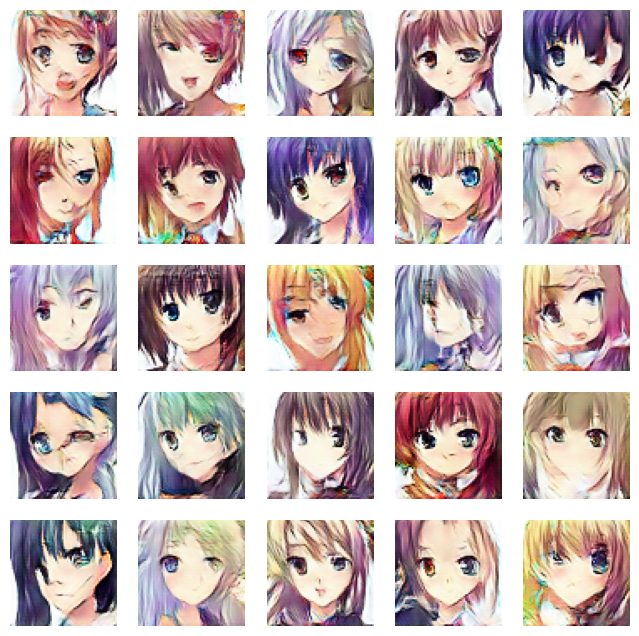

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.6935 - g_loss: 0.7663
Epoch 24/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6940 - g_loss: 0.7619

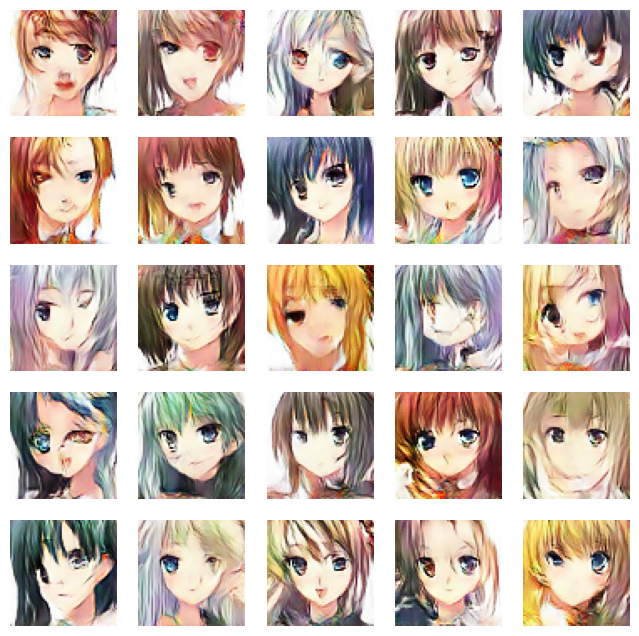

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.6940 - g_loss: 0.7619
Epoch 25/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6936 - g_loss: 0.7713

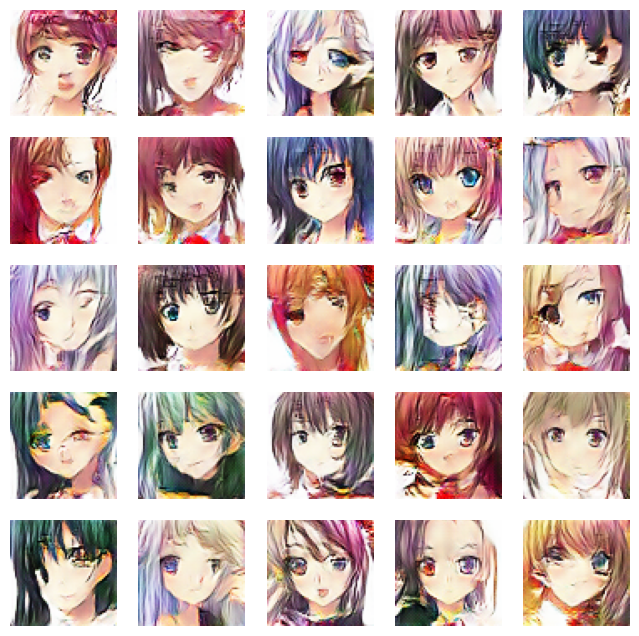

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.6936 - g_loss: 0.7713
Epoch 26/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6870 - g_loss: 0.7688

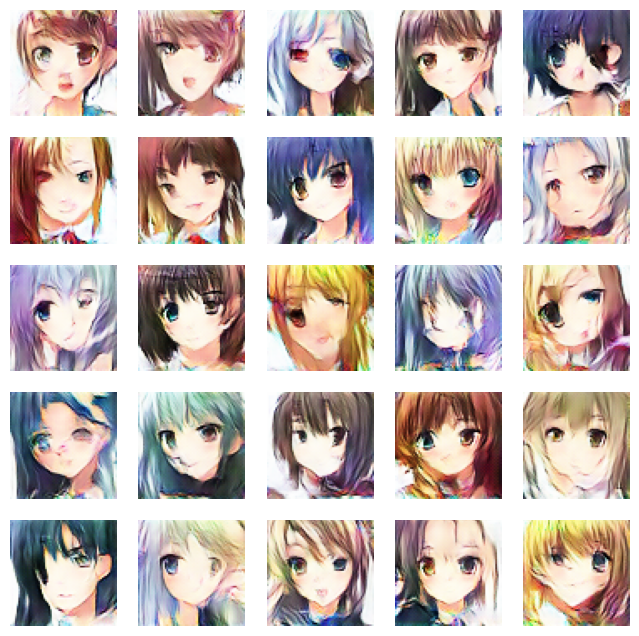

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.6870 - g_loss: 0.7688
Epoch 27/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6898 - g_loss: 0.7763

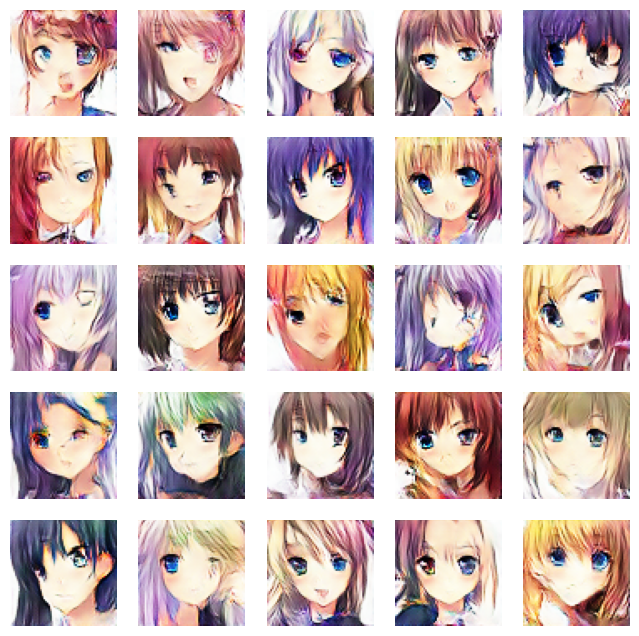

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 32ms/step - d_loss: 0.6898 - g_loss: 0.7763
Epoch 28/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6863 - g_loss: 0.7804

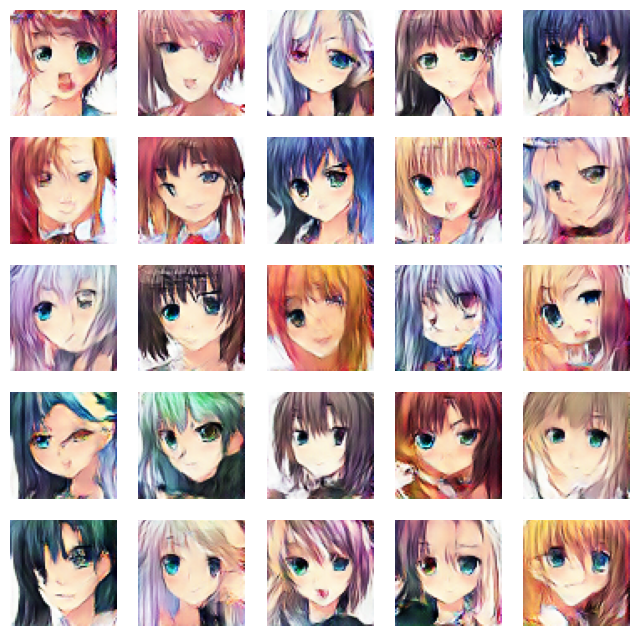

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.6863 - g_loss: 0.7804
Epoch 29/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6843 - g_loss: 0.7911

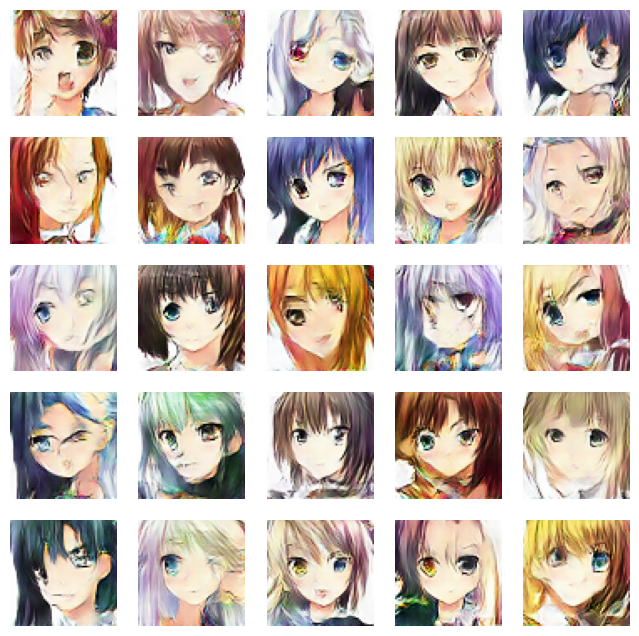

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.6843 - g_loss: 0.7911
Epoch 30/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6789 - g_loss: 0.7940

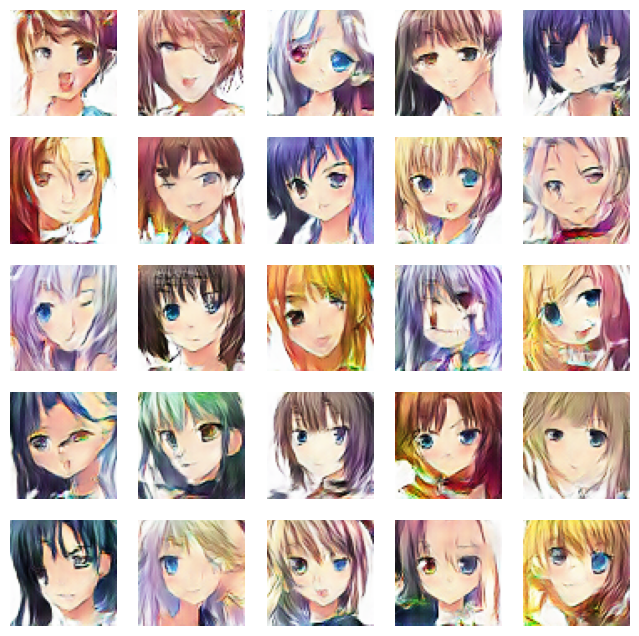

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.6789 - g_loss: 0.7940
Epoch 31/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6776 - g_loss: 0.8034

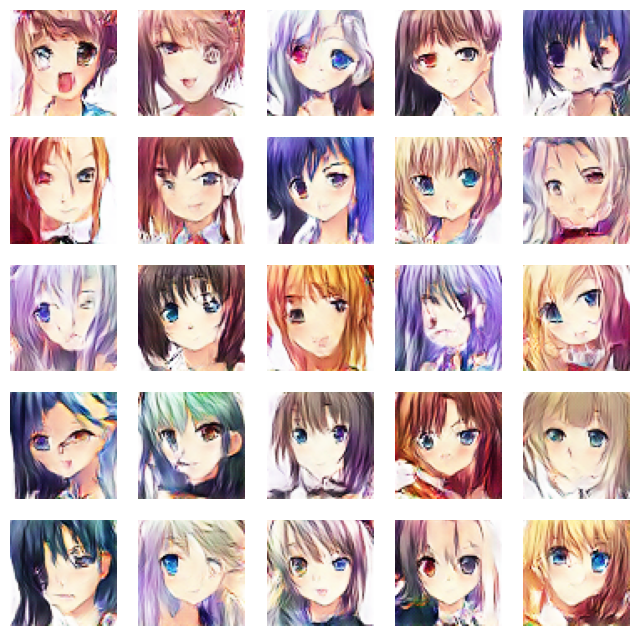

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.6776 - g_loss: 0.8034
Epoch 32/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6753 - g_loss: 0.8091

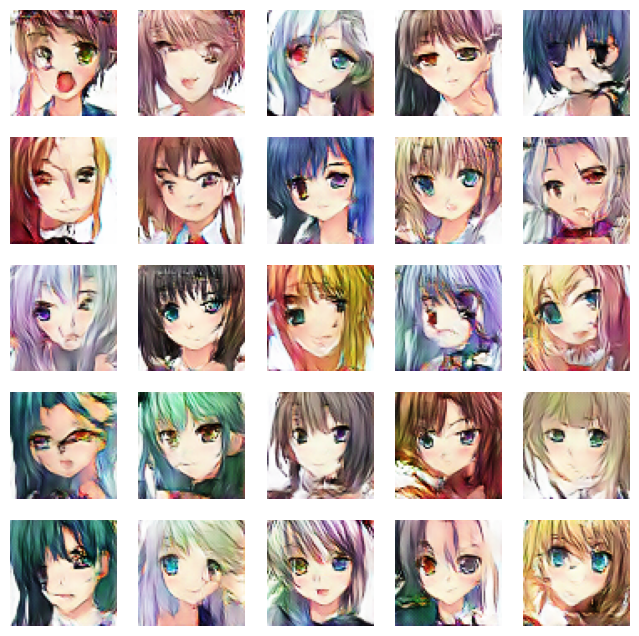

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 32ms/step - d_loss: 0.6753 - g_loss: 0.8091
Epoch 33/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - d_loss: 0.6718 - g_loss: 0.8150

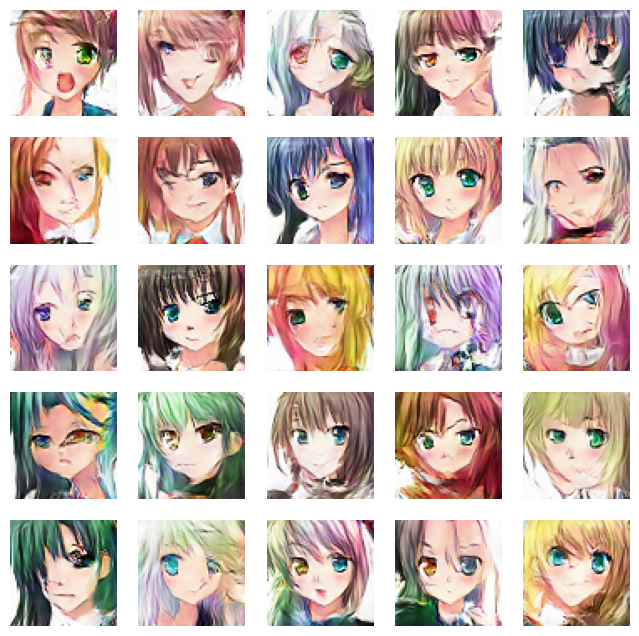

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.6718 - g_loss: 0.8150
Epoch 34/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - d_loss: 0.6685 - g_loss: 0.8308

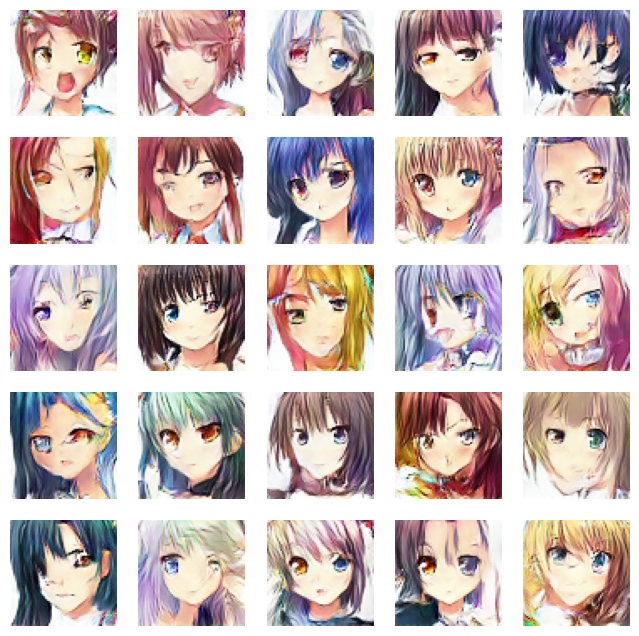

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.6685 - g_loss: 0.8308
Epoch 35/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6638 - g_loss: 0.8378

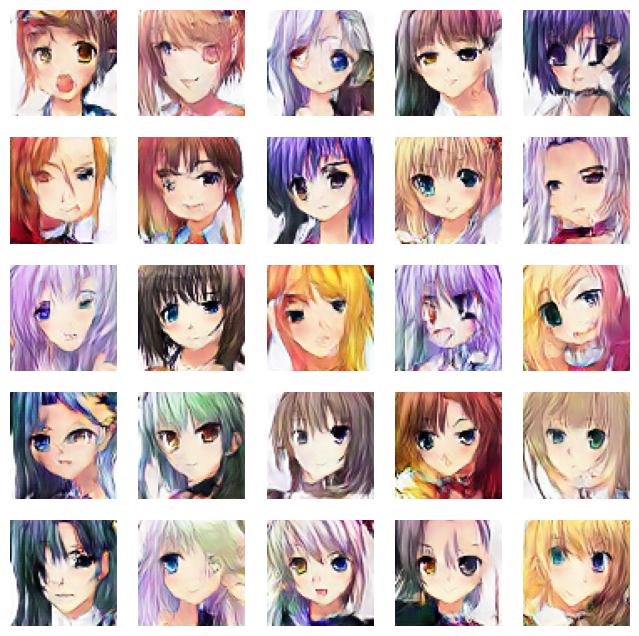

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.6638 - g_loss: 0.8378
Epoch 36/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6616 - g_loss: 0.8510

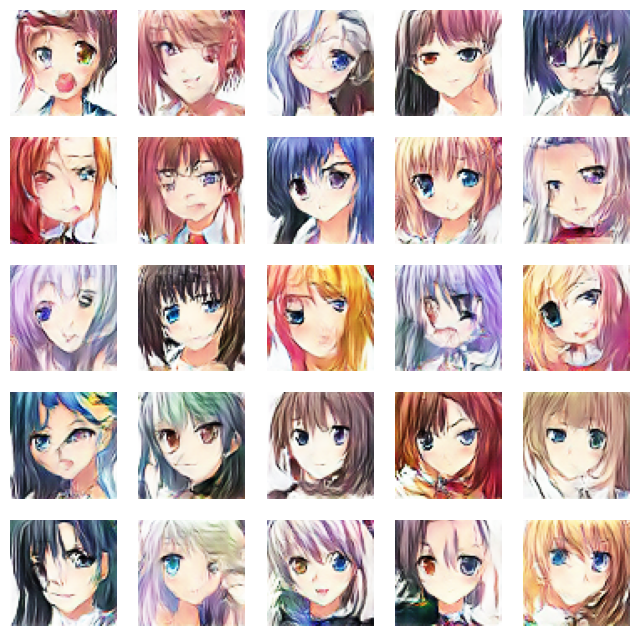

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.6616 - g_loss: 0.8510
Epoch 37/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6545 - g_loss: 0.8532

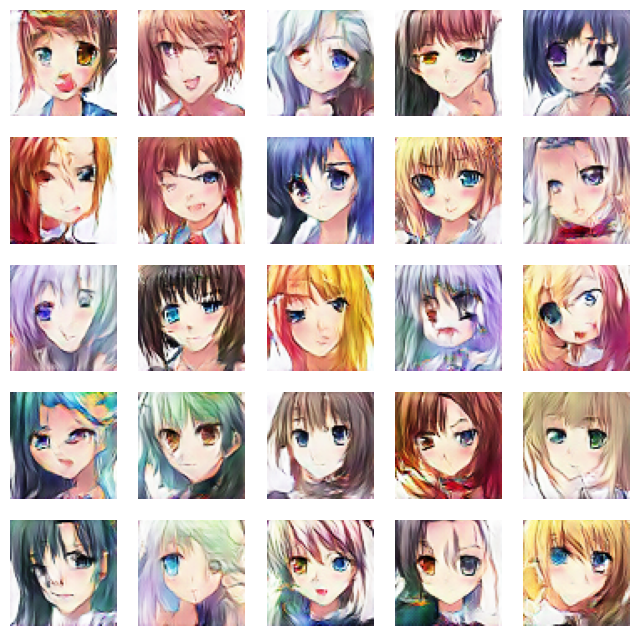

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.6545 - g_loss: 0.8532
Epoch 38/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6493 - g_loss: 0.8744

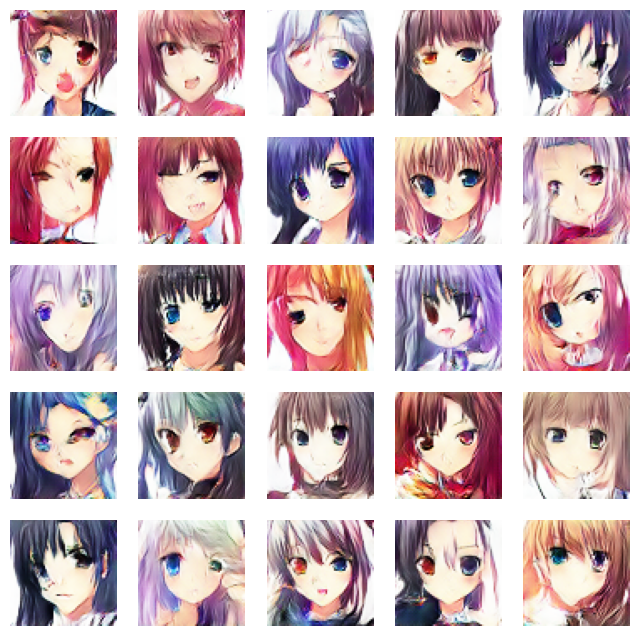

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.6493 - g_loss: 0.8744
Epoch 39/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6454 - g_loss: 0.8805

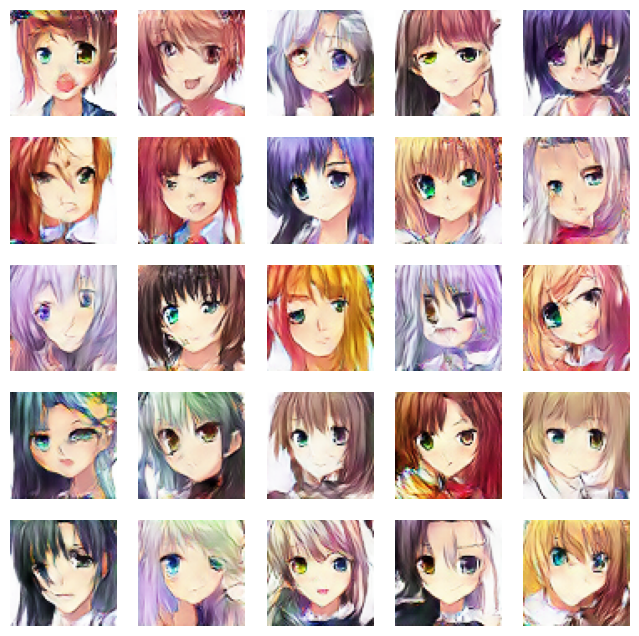

674/674 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - d_loss: 0.6454 - g_loss: 0.8805
Epoch 40/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6442 - g_loss: 0.8900

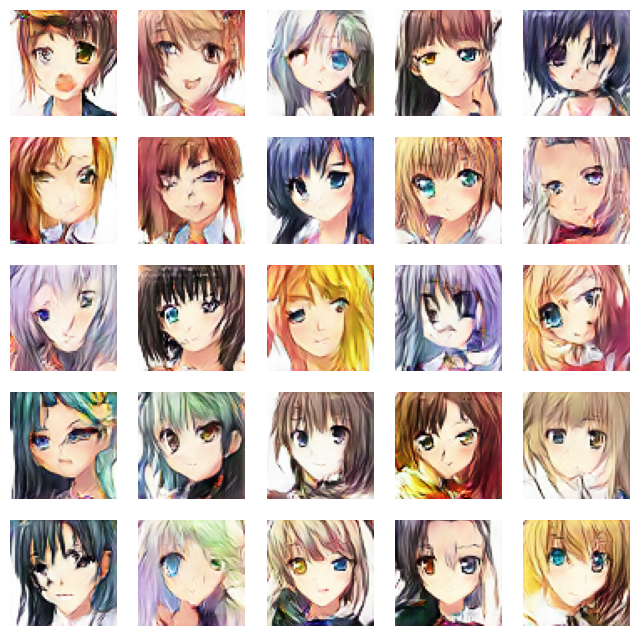

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.6442 - g_loss: 0.8901
Epoch 41/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6389 - g_loss: 0.9104

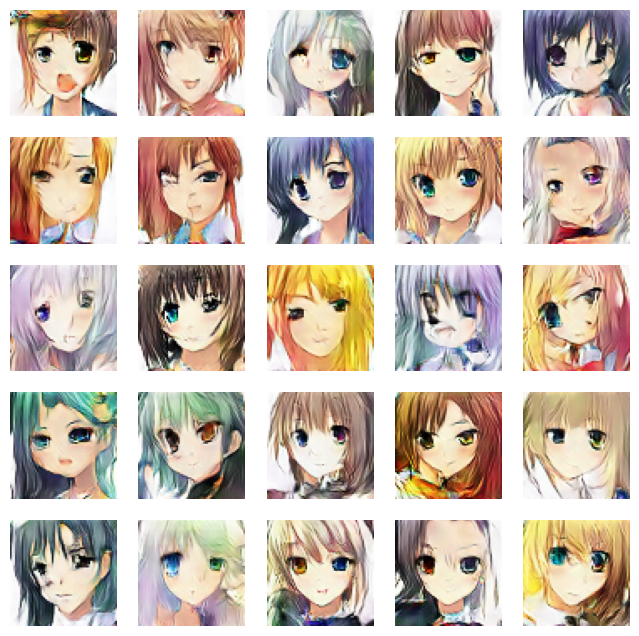

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 32ms/step - d_loss: 0.6389 - g_loss: 0.9104
Epoch 42/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6358 - g_loss: 0.9275

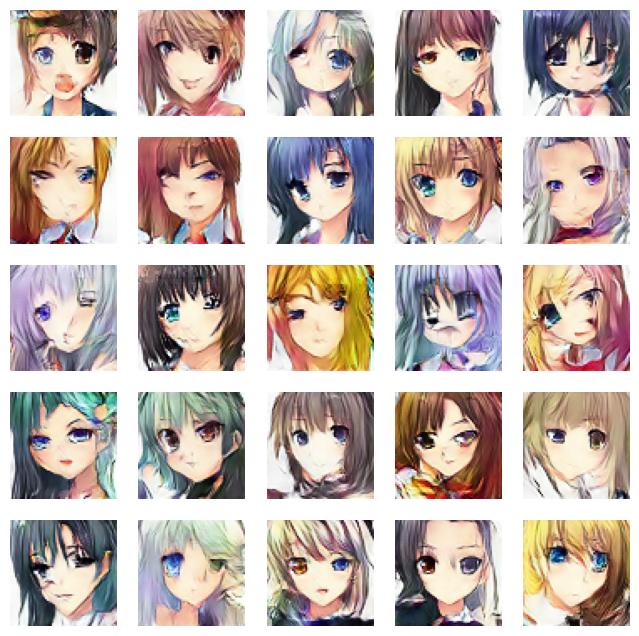

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.6358 - g_loss: 0.9275
Epoch 43/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6333 - g_loss: 0.9433

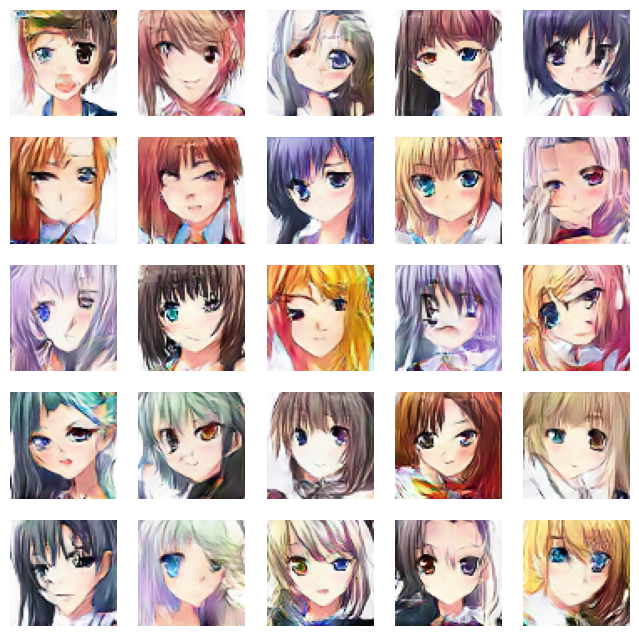

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.6333 - g_loss: 0.9432
Epoch 44/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6314 - g_loss: 0.9521

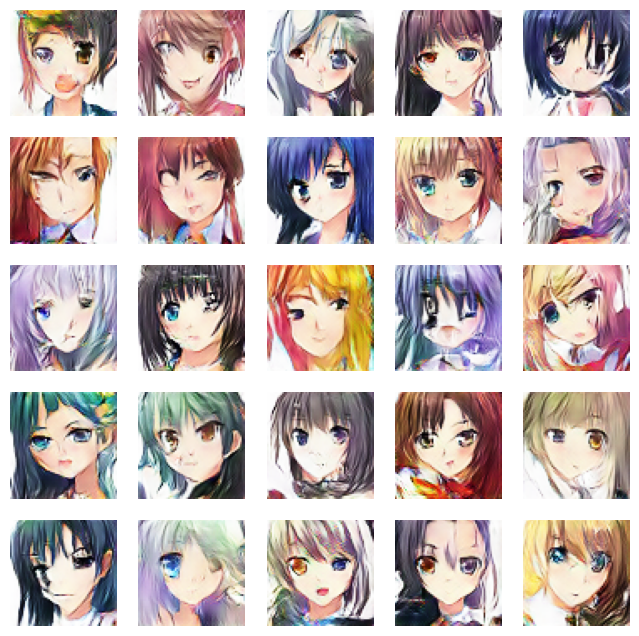

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.6314 - g_loss: 0.9521
Epoch 45/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6246 - g_loss: 0.9528

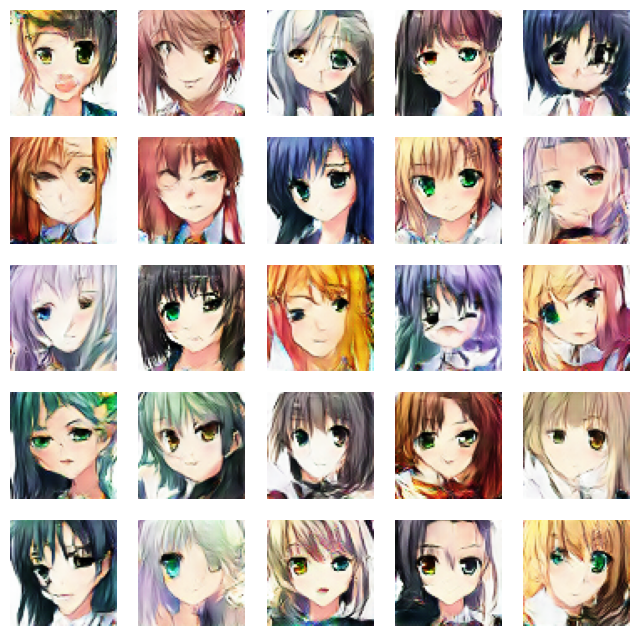

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.6246 - g_loss: 0.9529
Epoch 46/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6158 - g_loss: 0.9783

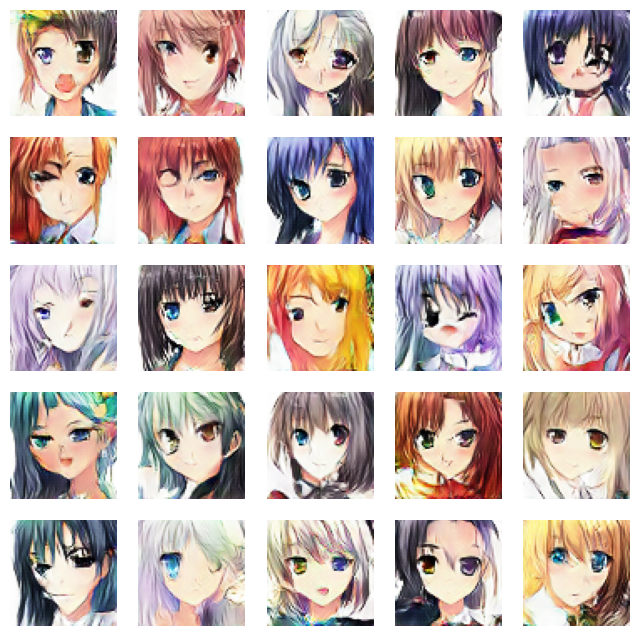

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.6158 - g_loss: 0.9783
Epoch 47/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6166 - g_loss: 0.9793

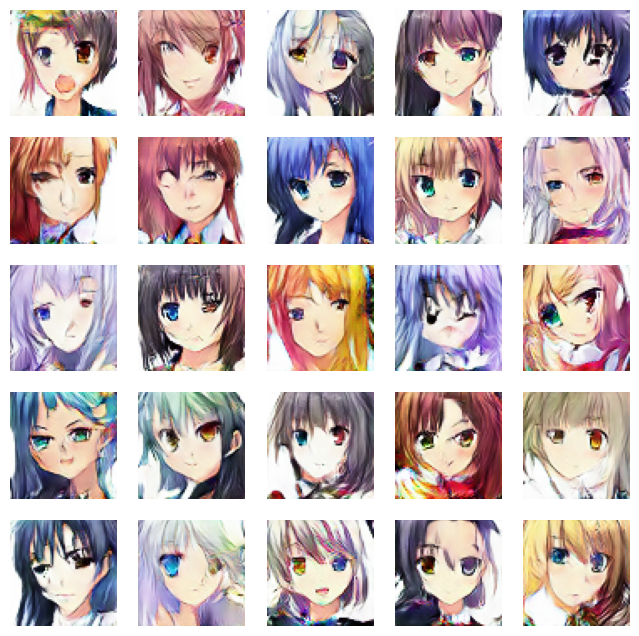

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.6166 - g_loss: 0.9793
Epoch 48/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6152 - g_loss: 1.0046

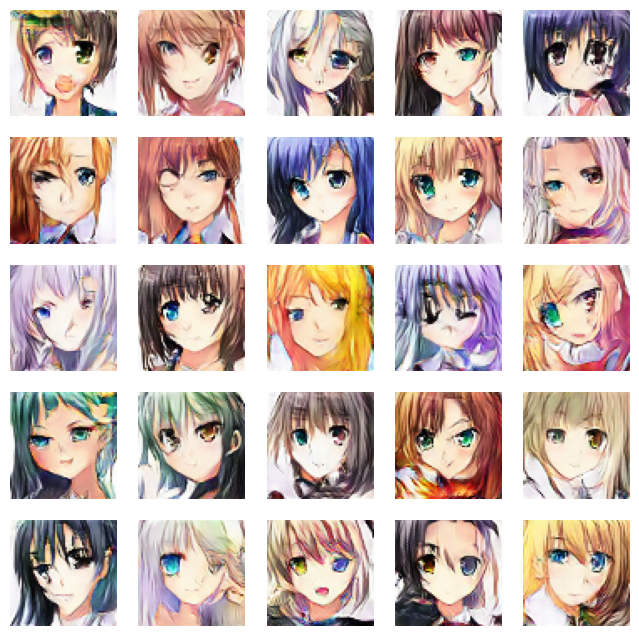

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.6152 - g_loss: 1.0046
Epoch 49/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6114 - g_loss: 1.0070

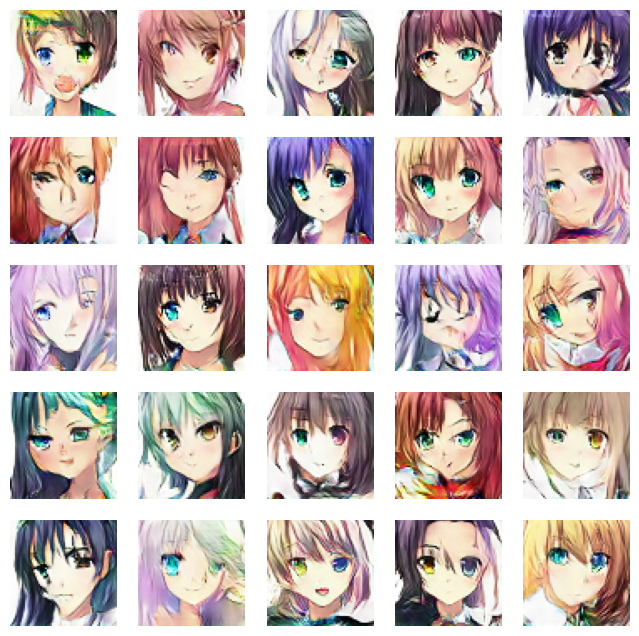

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.6114 - g_loss: 1.0070
Epoch 50/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6077 - g_loss: 1.0296

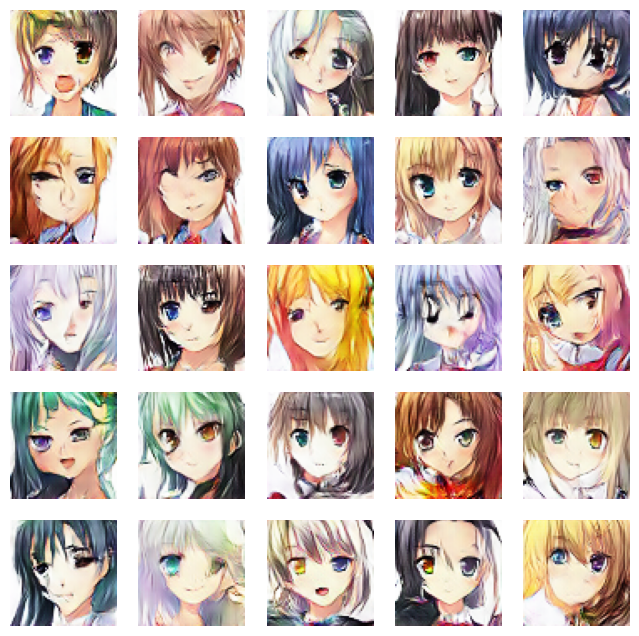

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 32ms/step - d_loss: 0.6077 - g_loss: 1.0296


In [48]:
N_EPOCHS=50
dcgan.fit(train_images,epochs=N_EPOCHS,callbacks=[DCGANMonitor()])

## Generate new images

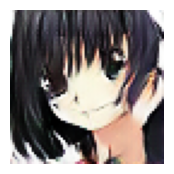

In [51]:
noise=tf.random.normal([1,100])

g_img=dcgan.generator(noise)
#denormalising the images
fig=plt.figure(figsize=(2,2))
g_img=(g_img*127.5) + 127.5
g_img.numpy()
img=array_to_img(g_img[0])
plt.imshow(img)
plt.axis("off")       
plt.show()